# Aquisição e Exploração dos dados

*Imports*

In [109]:
import pandas as pd 
import numpy as np 

In [110]:
df = pd.read_csv('results_novo2.csv', sep=';',usecols=[0,1,2])

In [111]:
df.reset_index(drop=True, inplace=True)
df.dropna(axis=0, inplace=True)
df

,ear,distancia_entre_os_labios,nome_video
0,0.291351,13.833333,55/0.mp4
1,0.296493,14.000000,55/0.mp4
2,0.316485,14.333333,55/0.mp4
3,0.321407,15.333333,55/0.mp4
4,0.290985,15.000000,55/0.mp4
...,...,...,...
3084074,0.380242,2.500000,54/5.mp4
3084075,0.393527,1.666667,54/5.mp4
3084076,0.388569,1.833333,54/5.mp4
3084077,0.400175,0.833333,54/5.mp4


In [112]:
videos = pd.unique(df.nome_video)
videos 

array(['55/0.mp4', '55/10.mp4', '55/5.mp4', '56/0.MOV', '56/10.MOV',
       '56/5.MOV', '57/0.MOV', '57/10.MOV', '57/5.MOV', '59/0.MOV',
       '59/10.MOV', '59/5.MOV', '60/0.mov', '60/10.mov', '60/5.mov',
       '01/0.mov', '01/10.MOV', '01/5.mov', '02/0.mov', '02/10.MOV',
       '02/5.MOV', '03/0.MOV', '03/10.mov', '03/5.mov', '04/0.mp4',
       '04/10.mp4', '04/5.mp4', '05/0.MOV', '05/10.MOV', '05/5.MOV',
       '06/0.mp4', '06/10.mp4', '06/5.mp4', '07/5.mp4', '09/0.mp4',
       '09/10.mp4', '09/5.mp4', '10/0.MOV', '10/10.MOV', '10/5.MOV',
       '11/0.mp4', '11/10.mp4', '11/5.mp4', '12/0.mp4', '12/10.mp4',
       '12/5.mp4', '14/10.mp4', '14/5.mp4', '15/0.mp4', '15/10.mp4',
       '15/5.mp4', '16/0.MOV', '16/10.MOV', '16/5.MOV', '17/0.mp4',
       '17/10.mp4', '17/5.mp4', '18/0.mov', '18/10.mov', '18/5.mov',
       '19/0.MOV', '19/10.MOV', '19/5.MOV', '20/0.mp4', '20/5.MOV',
       '21/0.MOV', '21/5.MOV', '22/0.MOV', '22/10.MOV', '22/5.MOV',
       '23/0.mp4', '23/10.mp4', '23/5.mp

In [113]:
videos_vazios = []
for video in videos:
    print(video)
    df_video = df.query("nome_video == '"+video+"'")
    df_falhas = df_video.query("ear==-1" and "distancia_entre_os_labios==-1")
    df_dados = df_video.query("ear!=-1" and "distancia_entre_os_labios!=-1")

    print(df_falhas.shape[0], df_dados.shape[0])
    if df_dados.shape[0]<len(df_video)*0.5:
        videos_vazios.append(video)
        # df.query("nome_video != '"+video+"'", inplace=True) #filtrando dataframe antigo

55/0.mp4
8 21188
55/10.mp4
7514 8969
55/5.mp4
510 18725
56/0.MOV
0 18323
56/10.MOV
0 18778
56/5.MOV
9127 9227
57/0.MOV
15 18923
57/10.MOV
0 18367
57/5.MOV
42 18178
59/0.MOV
13 18076
59/10.MOV
0 18095
59/5.MOV
0 18169
60/0.mov
4668 13386
60/10.mov
471 18110
60/5.mov
91 17442
01/0.mov
1145 16904
01/10.MOV
1766 16245
01/5.mov
584 17385
02/0.mov
40 18219
02/10.MOV
1216 16908
02/5.MOV
12873 4171
03/0.MOV
134 20625
03/10.mov
0 18480
03/5.mov
80 18434
04/0.mp4
826 14538
04/10.mp4
3 15391
04/5.mp4
1883 16341
05/0.MOV
245 18161
05/10.MOV
6638 11412
05/5.MOV
14582 3476
06/0.mp4
3945 11285
06/10.mp4
680 9553
06/5.mp4
4898 8219
07/5.mp4
22 17864
09/0.mp4
72 18100
09/10.mp4
87 19729
09/5.mp4
1482 16885
10/0.MOV
0 16306
10/10.MOV
0 18866
10/5.MOV
3 18617
11/0.mp4
39 18779
11/10.mp4
32 10624
11/5.mp4
154 9699
12/0.mp4
0 16919
12/10.mp4
241 14857
12/5.mp4
554 18284
14/10.mp4
60 18632
14/5.mp4
196 19546
15/0.mp4
2831 16470
15/10.mp4
18 18465
15/5.mp4
10552 7989
16/0.MOV
528 10829
16/10.MOV
861 13630
16

In [114]:
df

,ear,distancia_entre_os_labios,nome_video
0,0.291351,13.833333,55/0.mp4
1,0.296493,14.000000,55/0.mp4
2,0.316485,14.333333,55/0.mp4
3,0.321407,15.333333,55/0.mp4
4,0.290985,15.000000,55/0.mp4
...,...,...,...
3084074,0.380242,2.500000,54/5.mp4
3084075,0.393527,1.666667,54/5.mp4
3084076,0.388569,1.833333,54/5.mp4
3084077,0.400175,0.833333,54/5.mp4


In [115]:
len(videos_vazios), len(videos)

(24, 180)

In [74]:
len(pd.unique(df.nome_video)) #dados limpo

169

In [75]:
# df.to_csv('results_novo.csv', sep=';', index = False, mode='w', header=False)

In [76]:
df.nome_video

0          55/0.mp4
1          55/0.mp4
2          55/0.mp4
3          55/0.mp4
4          55/0.mp4
             ...   
3084074    54/5.mp4
3084075    54/5.mp4
3084076    54/5.mp4
3084077    54/5.mp4
3084078    54/5.mp4
Name: nome_video, Length: 2872538, dtype: object

In [77]:
# df.query('nome_video!=videos_vazios')

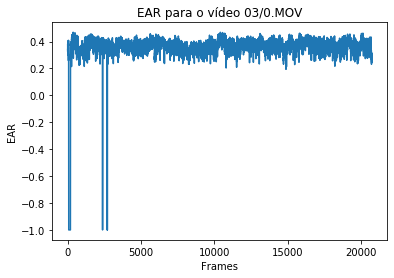

In [101]:
def video_relevante(df_filtrado, treshold):
    df_dados = df_filtrado.query("ear!=-1" and "distancia_entre_os_labios!=-1")

    print(treshold)
    if df_dados.shape[0]<treshold:
        return False
    else:
        return True

def plot_video_ear_graph(df, video_name, treshold_percentage = 0.3):
    df_ear_filtered = df.query("nome_video == '"+video_name+"'")
    plt.title('EAR para o vídeo ' + video_name)
    plt.xlabel('Frames')
    plt.ylabel('EAR')

    if video_relevante(df_ear_filtered, len(df_ear_filtered['ear'])*treshold_percentage):
        plt.plot(range(len(df_ear_filtered['ear'])), df_ear_filtered['ear'])
        plt.show()

plot_video_ear_graph(df, '03/0.MOV')

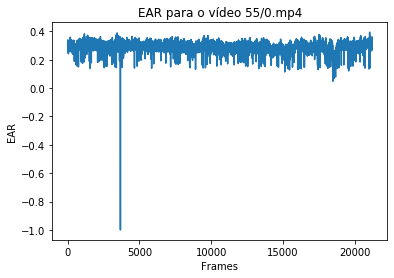

0


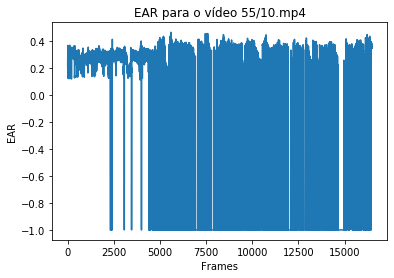

1


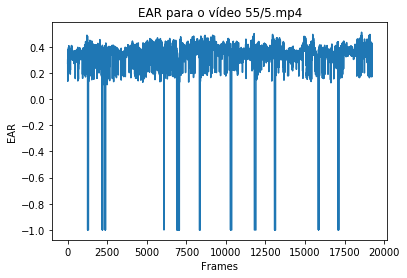

2


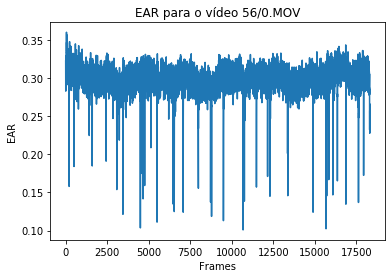

3


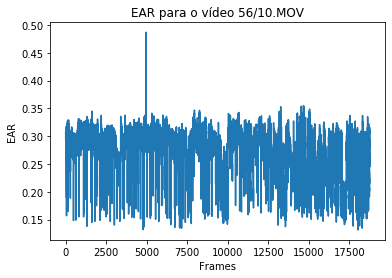

4


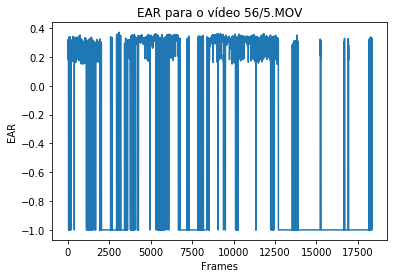

5


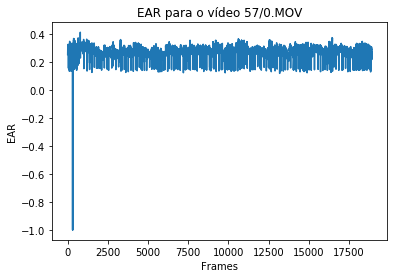

6


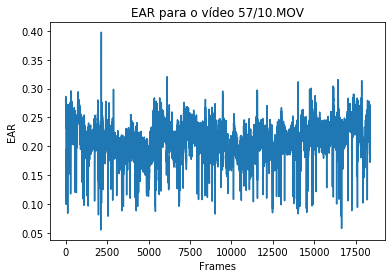

7


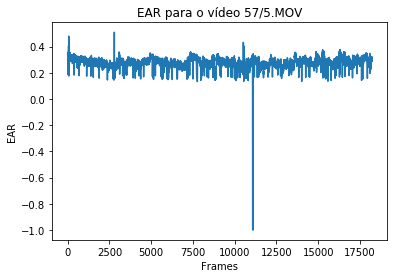

8


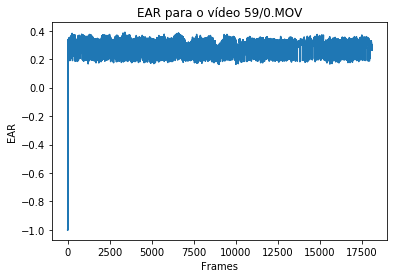

9


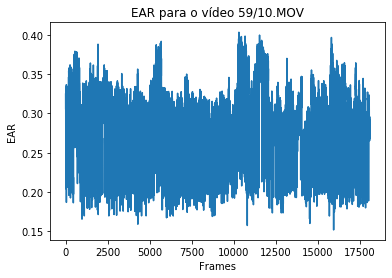

10


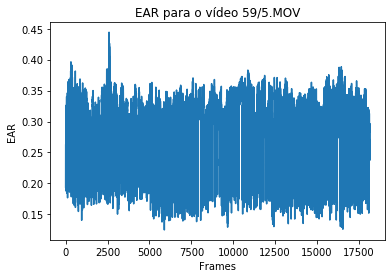

11


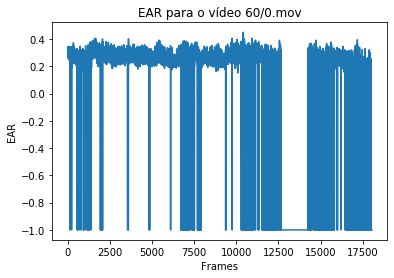

12


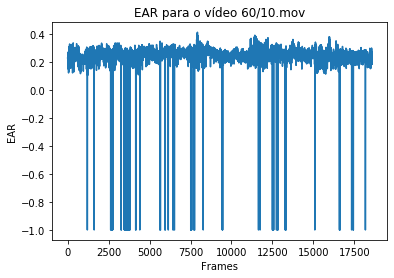

13


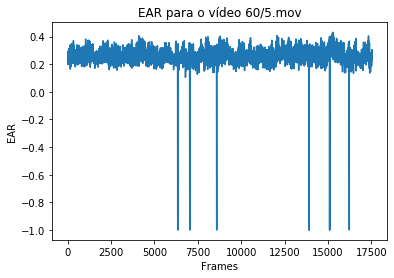

14


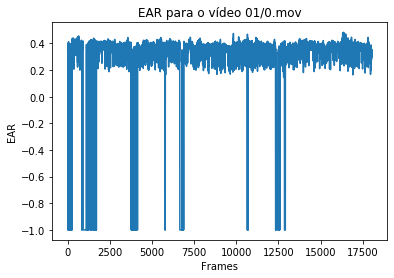

15


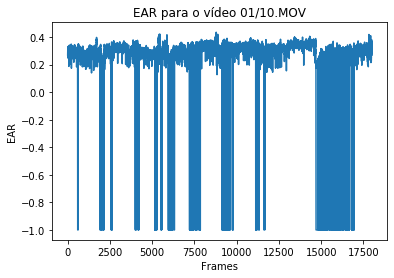

16


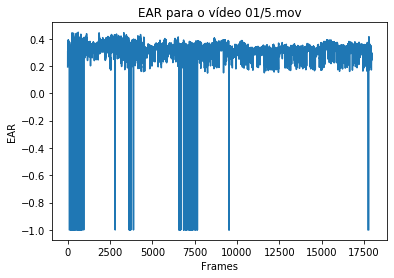

17


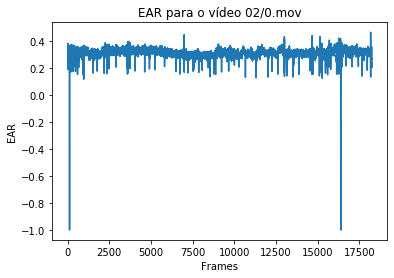

18


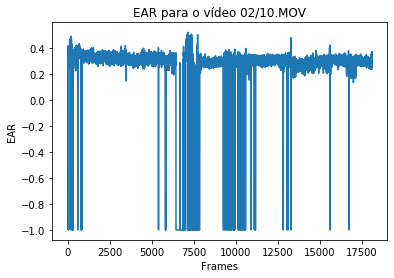

19
20


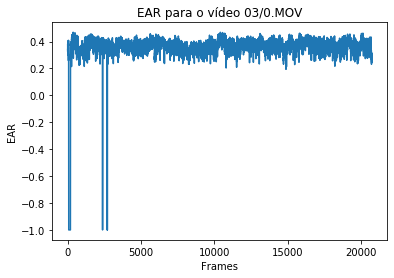

21


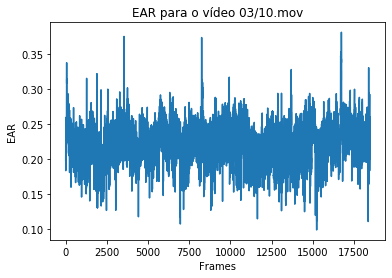

22


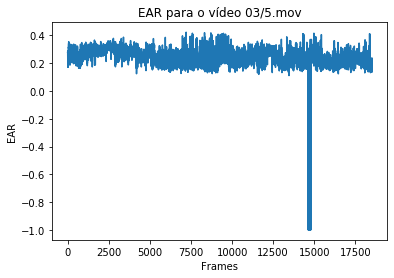

23


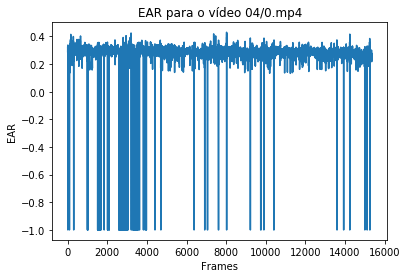

24


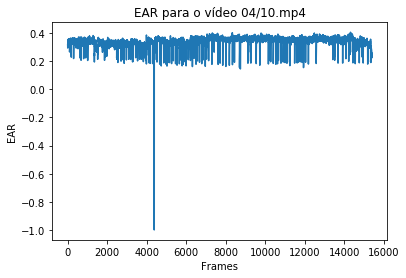

25


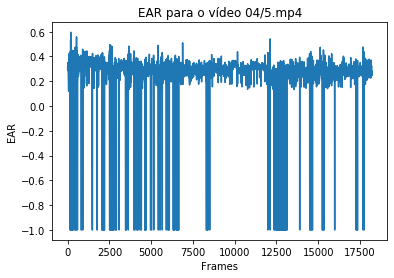

26


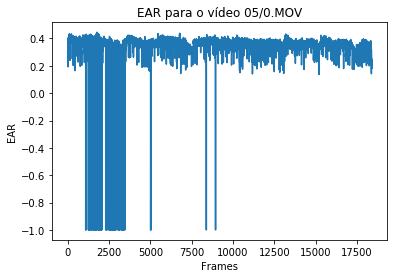

27


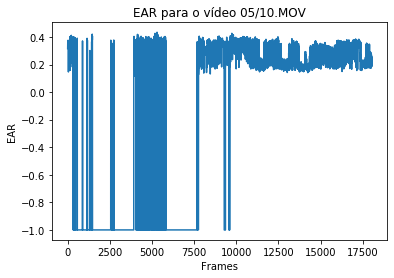

28
29


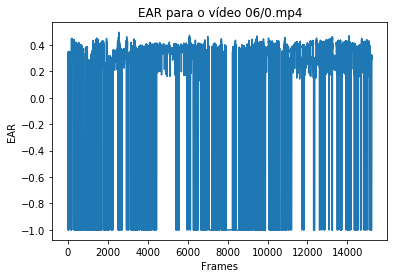

30


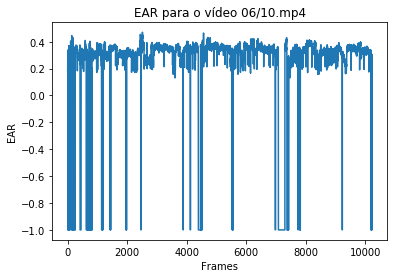

31


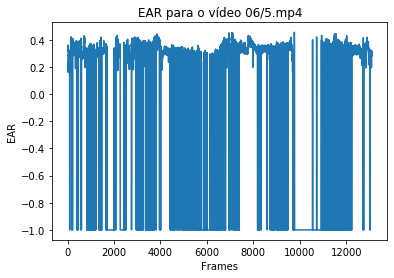

32


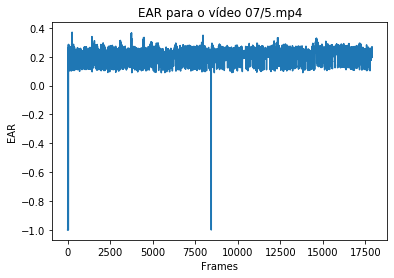

33


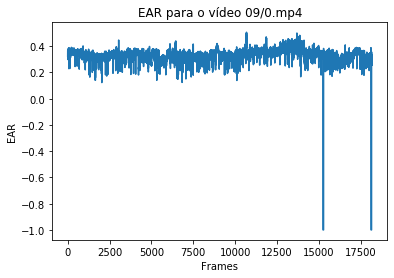

34


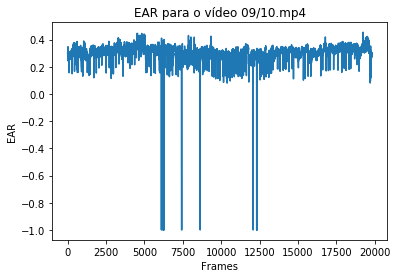

35


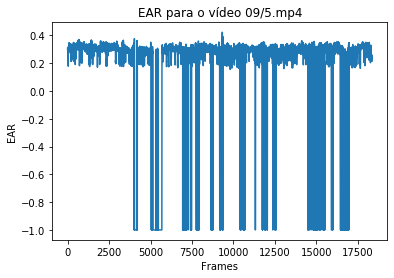

36


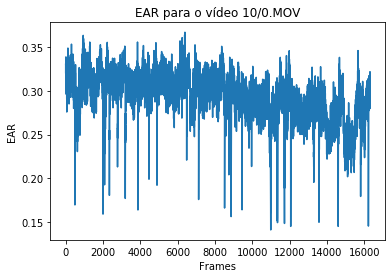

37


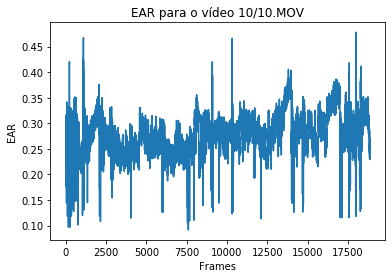

38


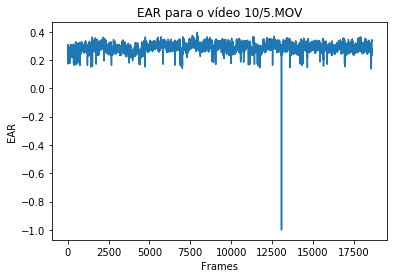

39


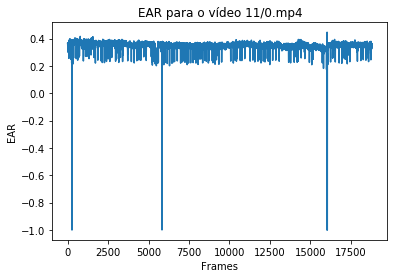

40


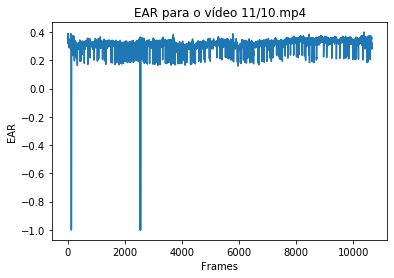

41


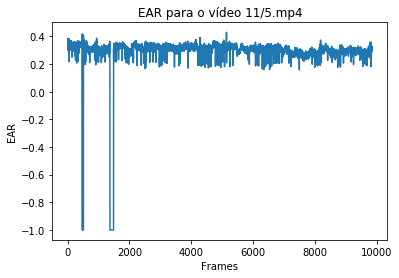

42


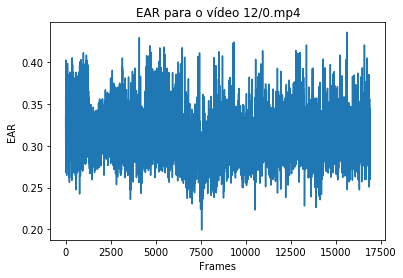

43


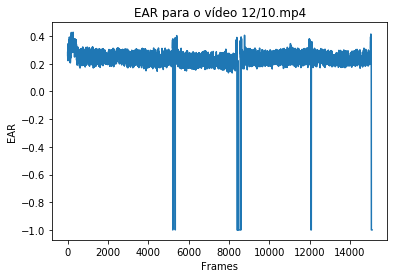

44


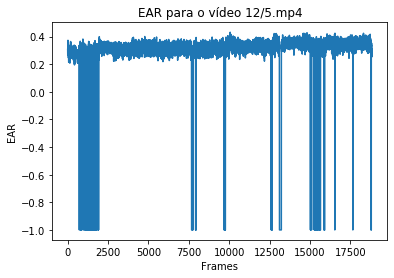

45


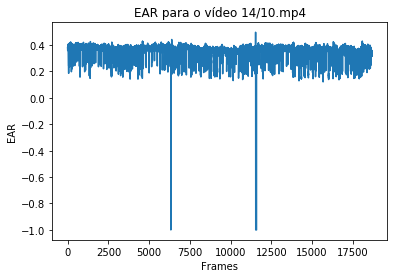

46


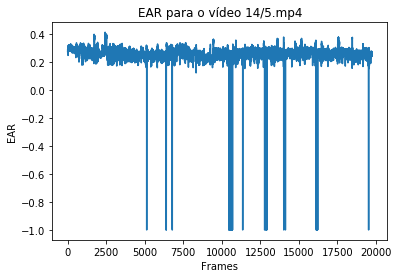

47


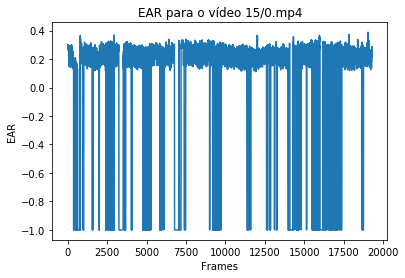

48


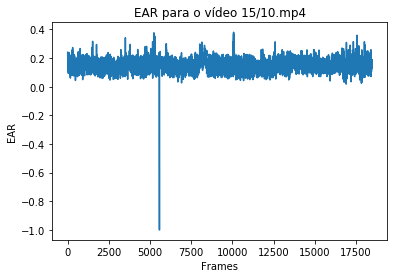

49


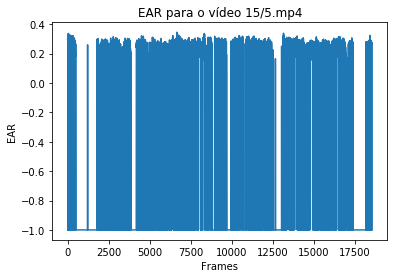

50


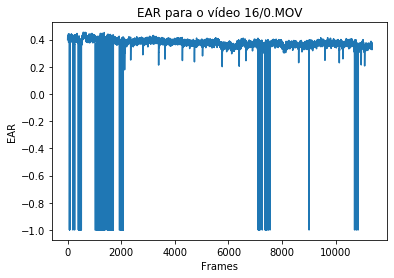

51


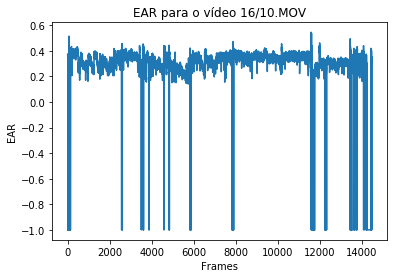

52


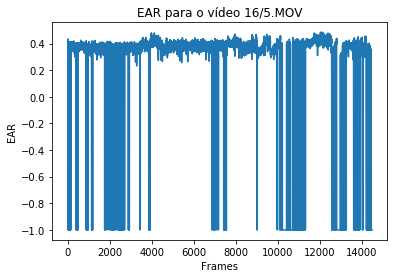

53


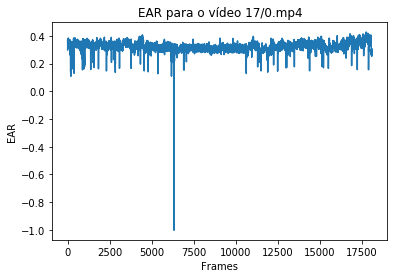

54


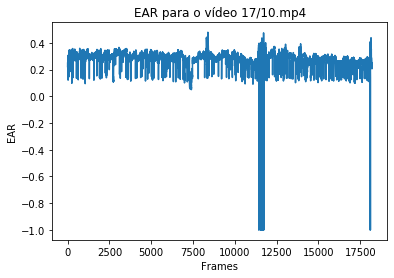

55


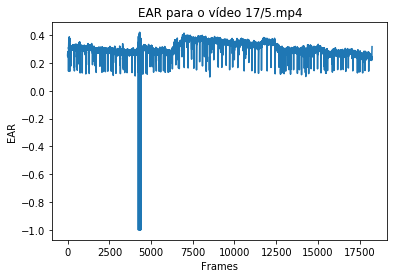

56


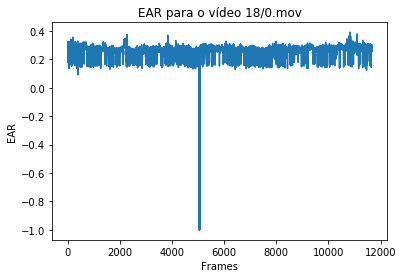

57


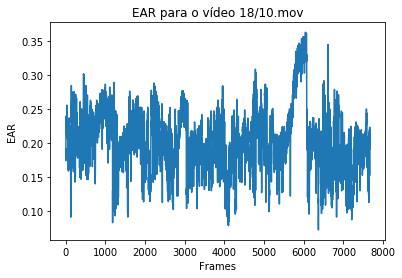

58


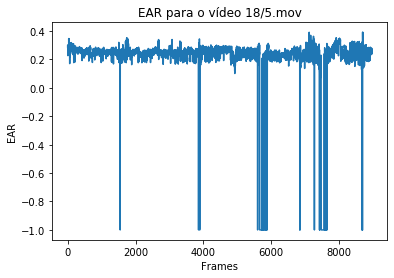

59


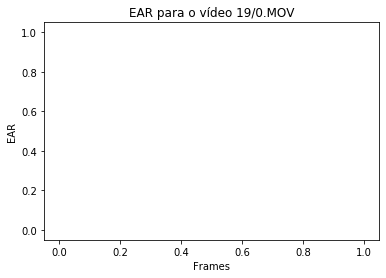

60


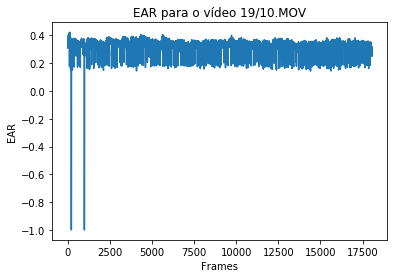

61


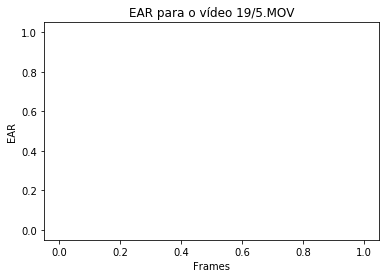

62


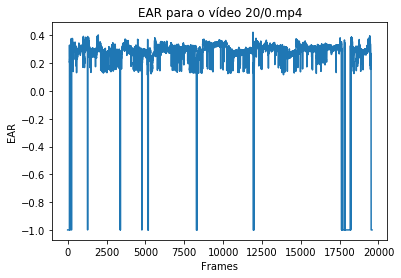

63


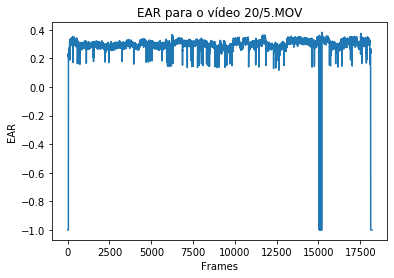

64


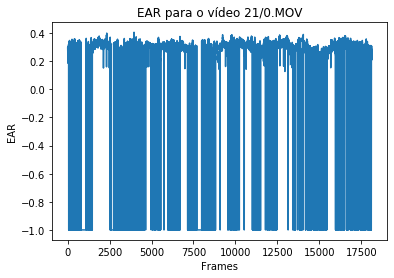

65


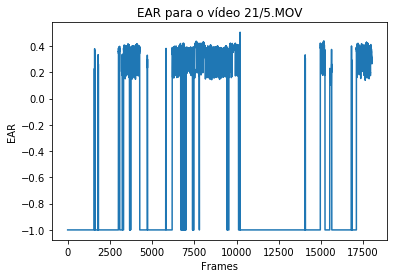

66


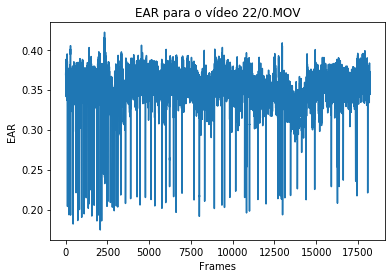

67


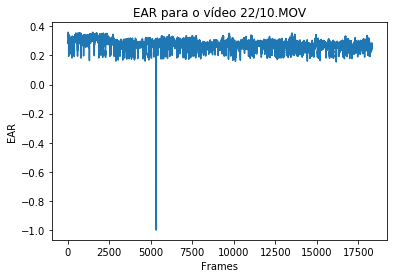

68


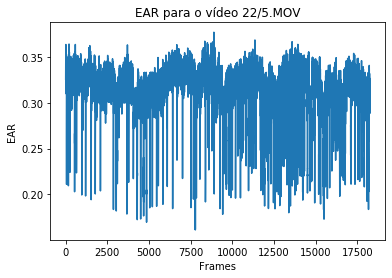

69


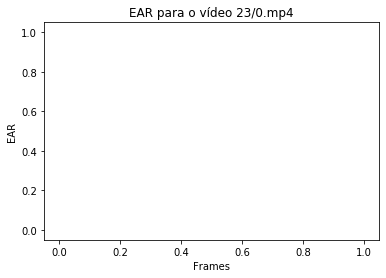

70


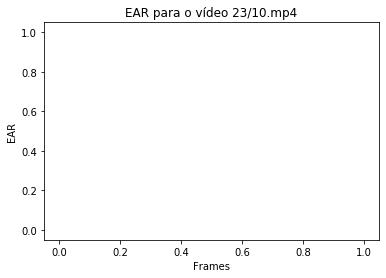

71
72


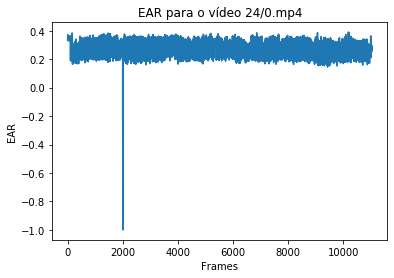

73


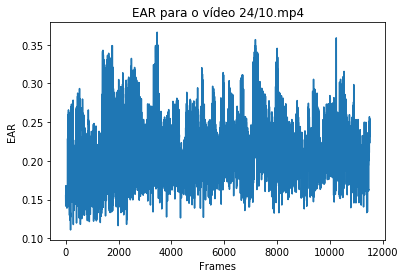

74


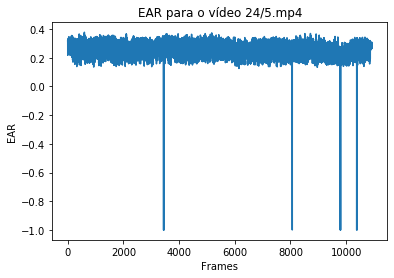

75


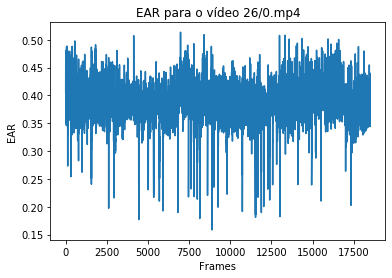

76


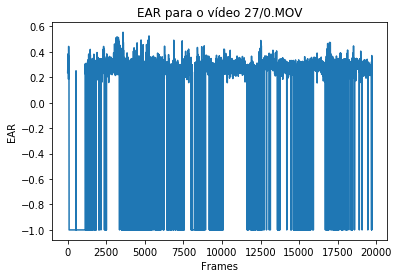

77
78


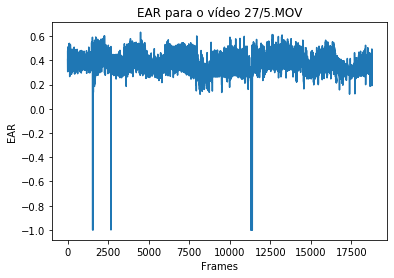

79


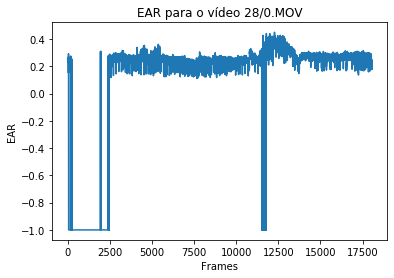

80


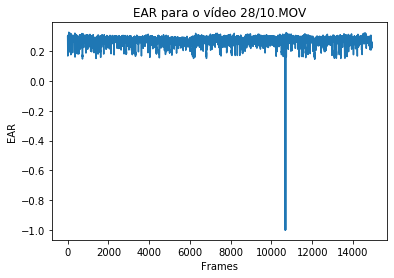

81


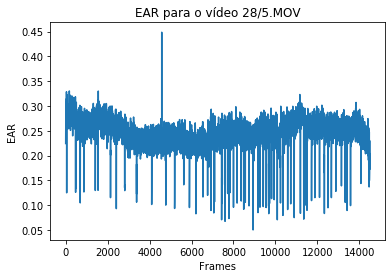

82


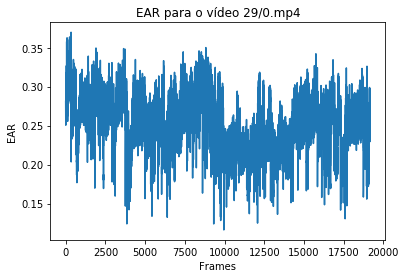

83


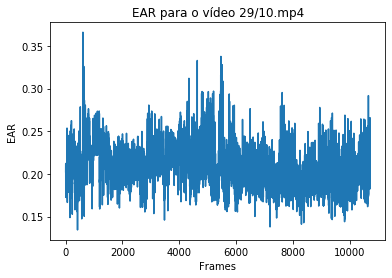

84


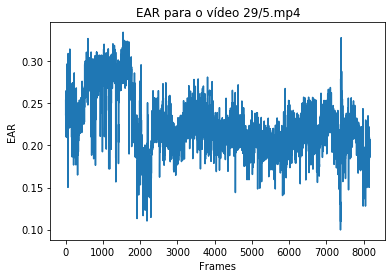

85


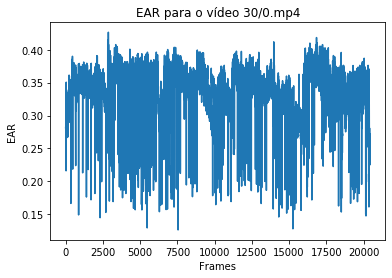

86


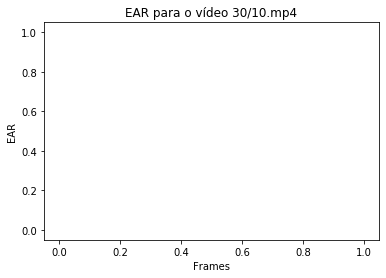

87


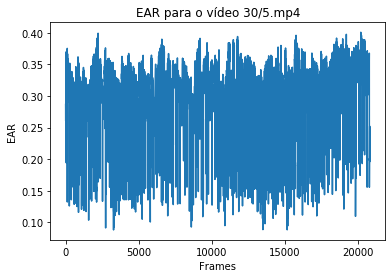

88


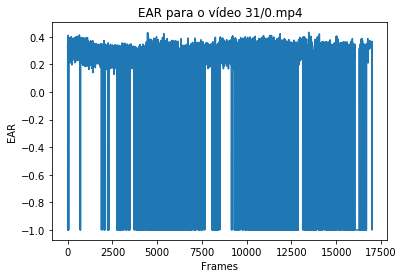

89


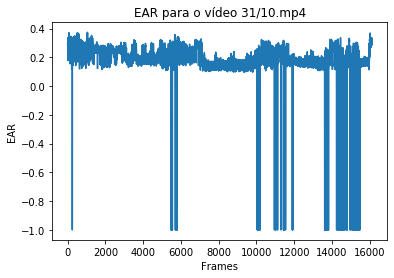

90


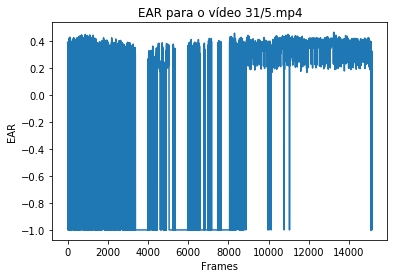

91


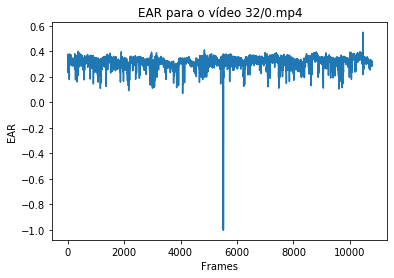

92


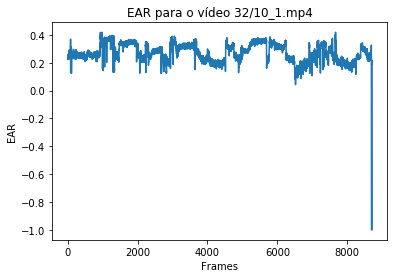

93


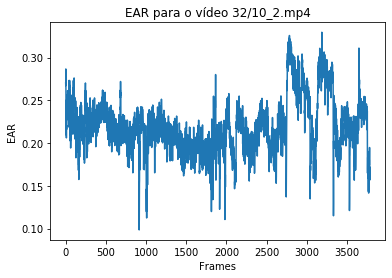

94


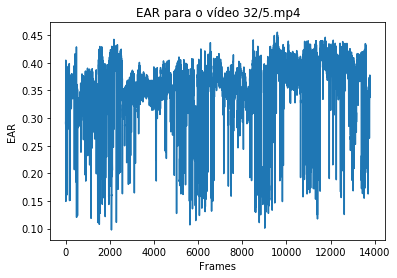

95


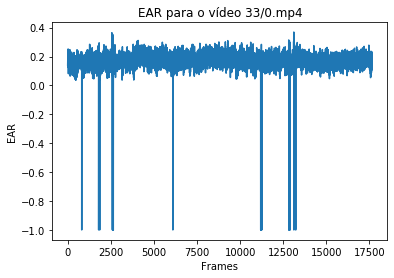

96
97


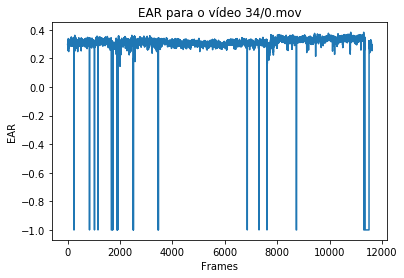

98


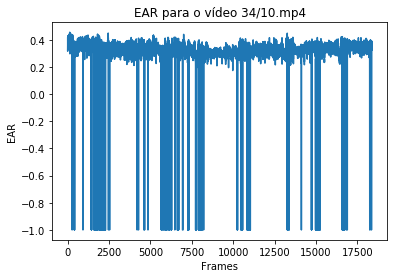

99


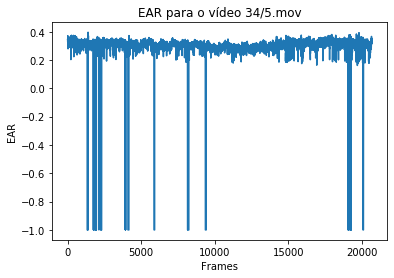

100


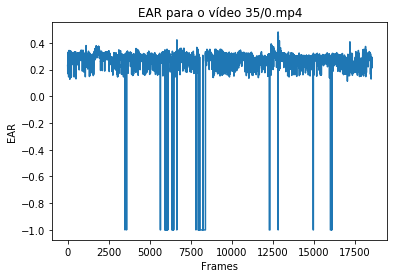

101


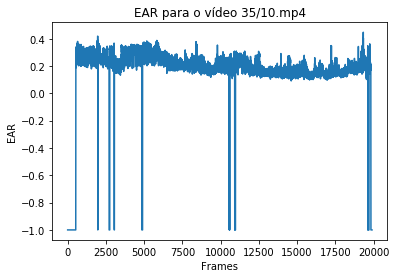

102


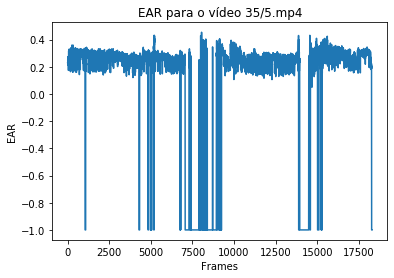

103


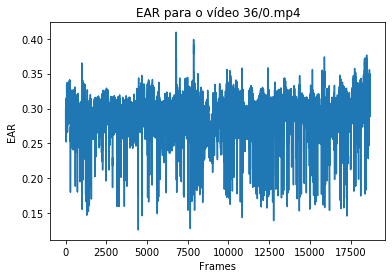

104


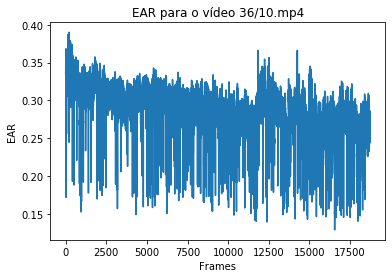

105


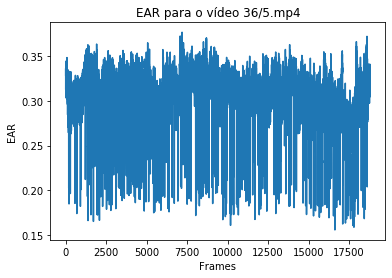

106


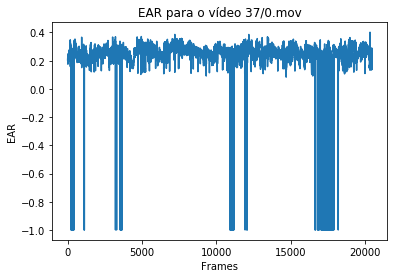

107


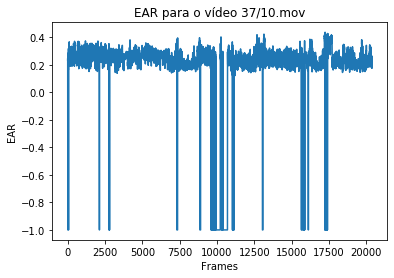

108


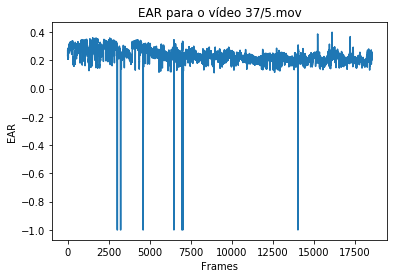

109


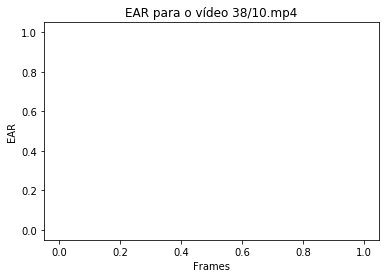

110


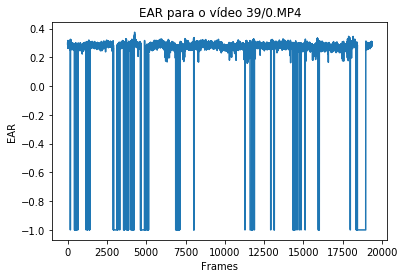

111


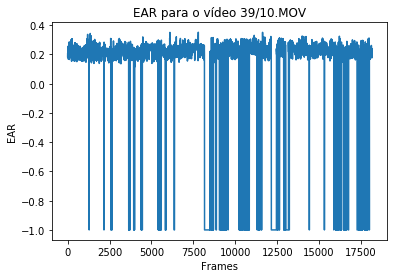

112


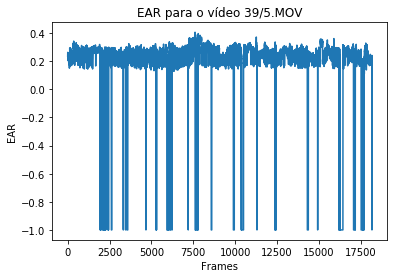

113


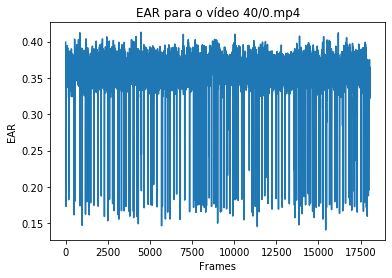

114


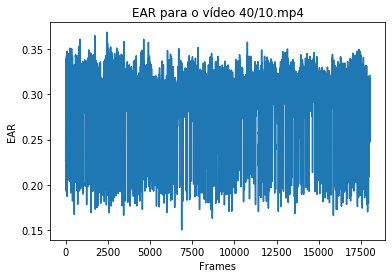

115


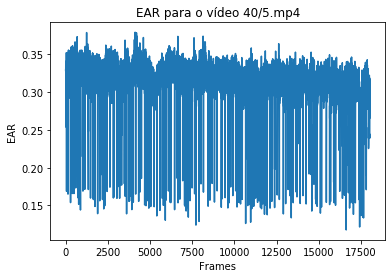

116


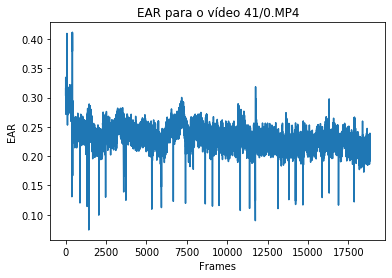

117


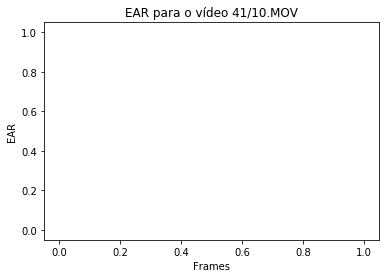

118


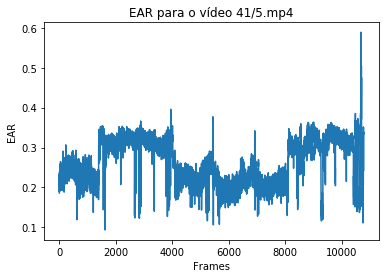

119


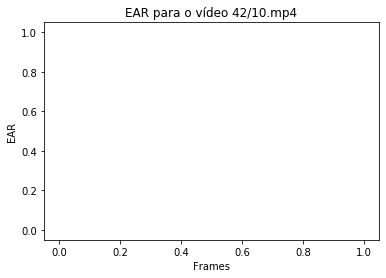

120


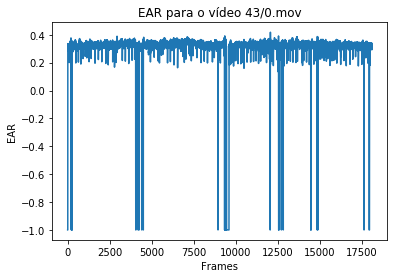

121


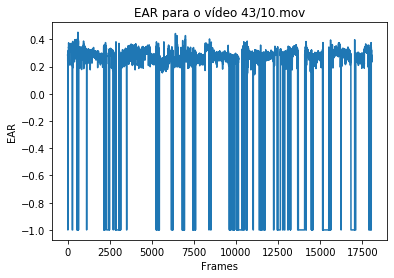

122


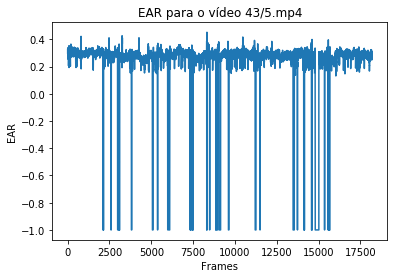

123


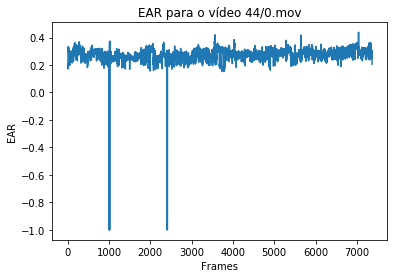

124


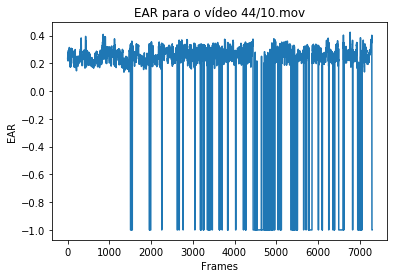

125


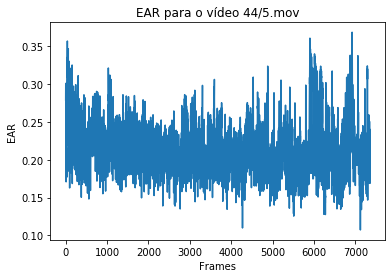

126


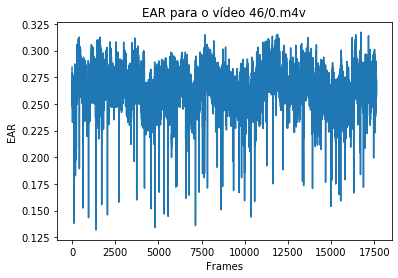

127


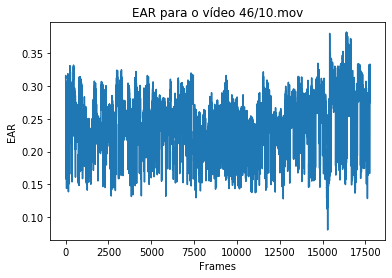

128


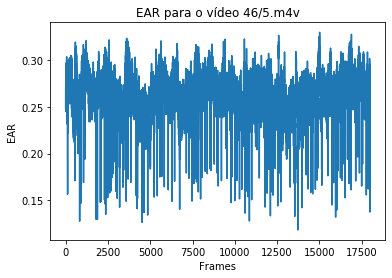

129


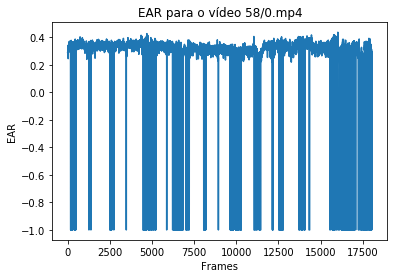

130


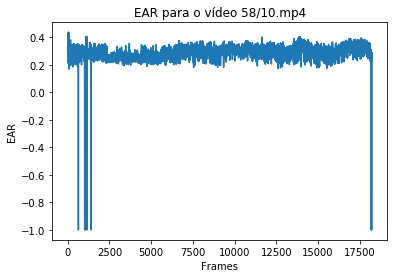

131


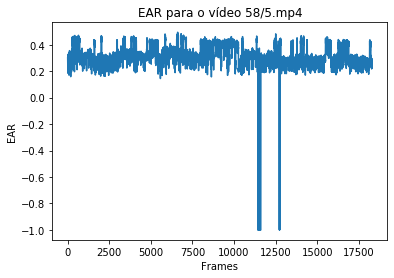

132


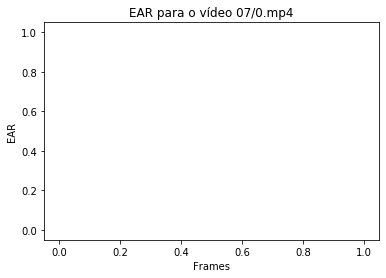

133


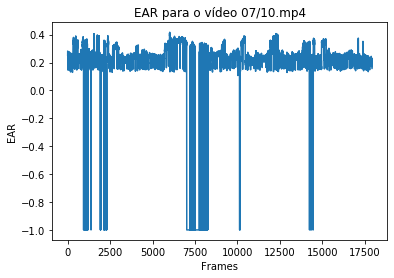

134


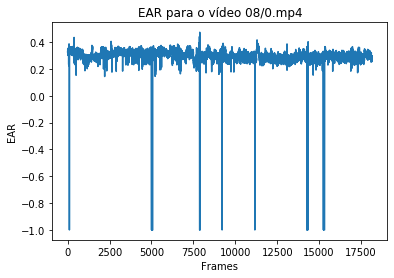

135


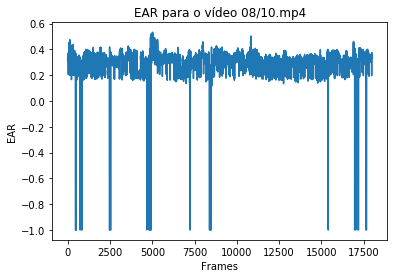

136


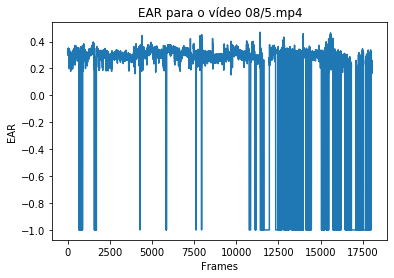

137
138


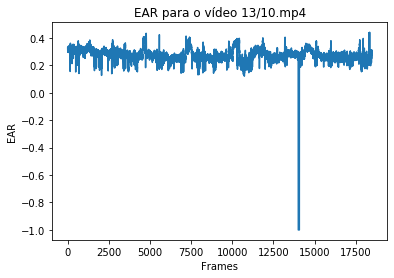

139


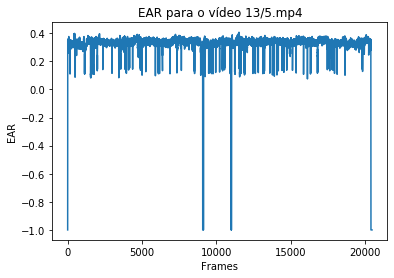

140


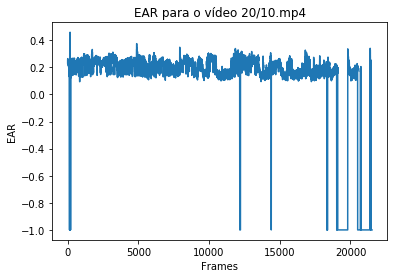

141
142


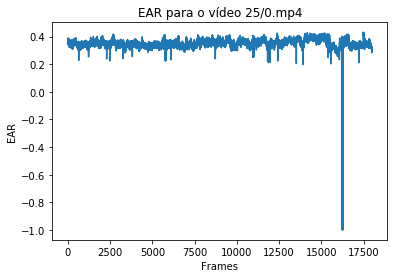

143


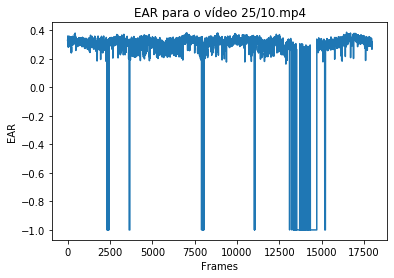

144


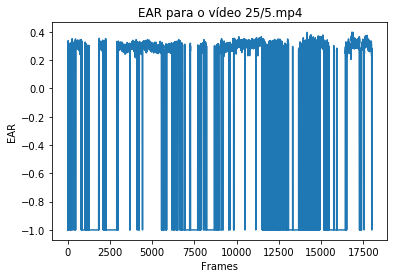

145


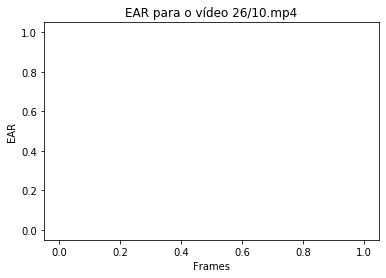

146
147


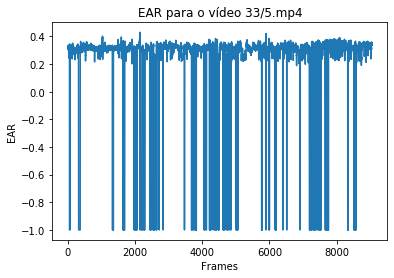

148


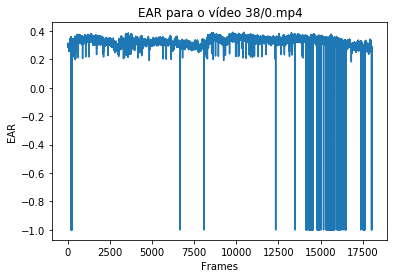

149


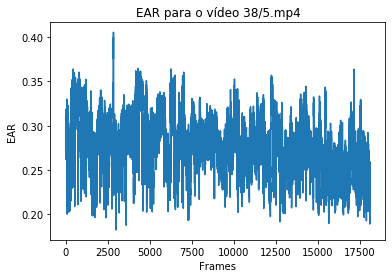

150


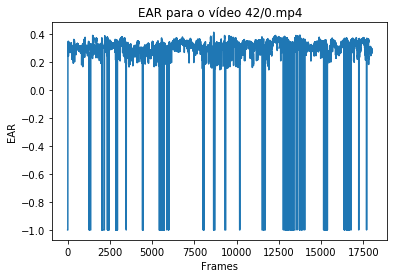

151


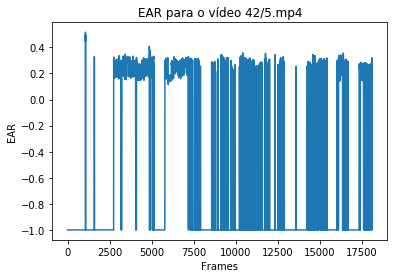

152


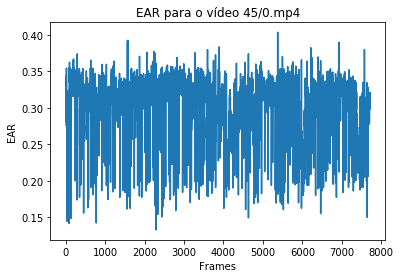

153


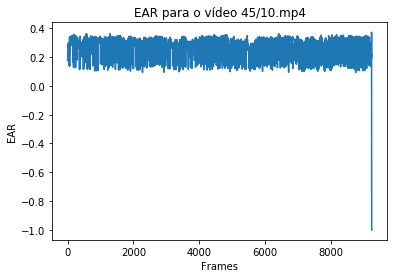

154


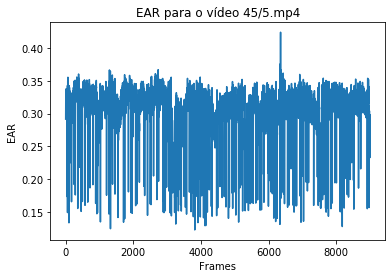

155


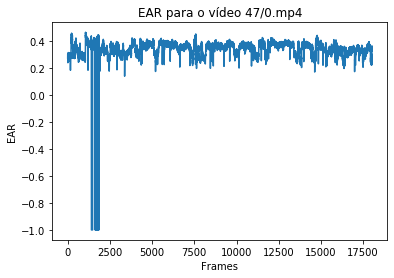

156


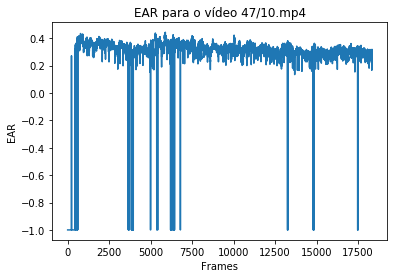

157


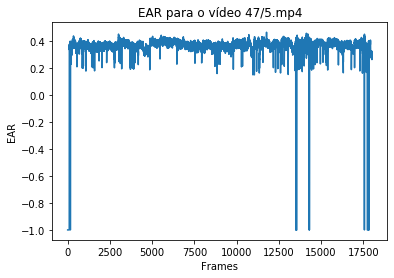

158


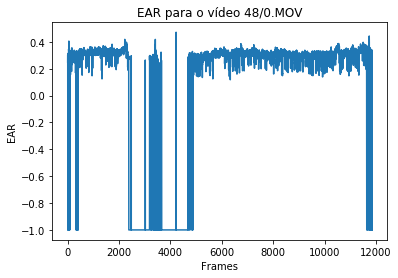

159


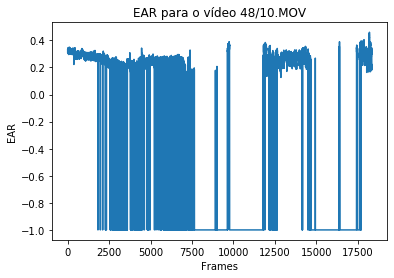

160


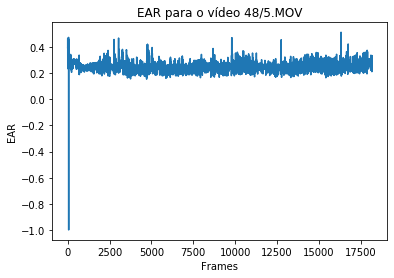

161


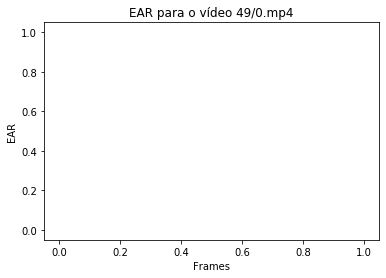

162
163


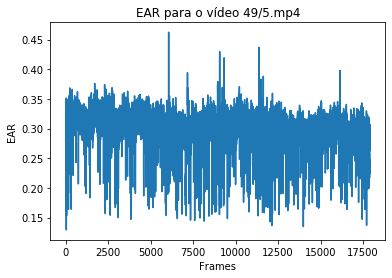

164


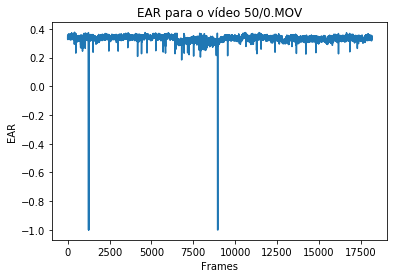

165


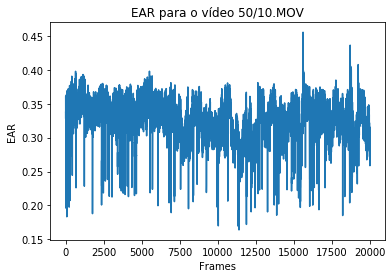

166


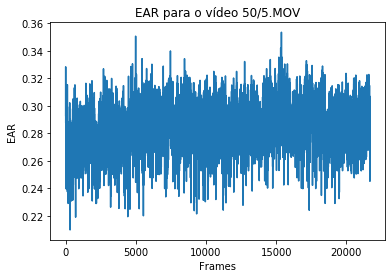

167


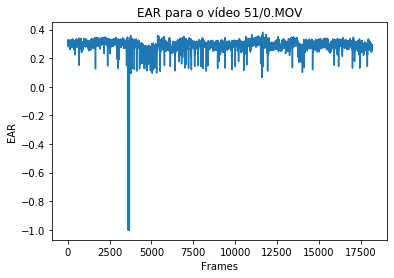

168


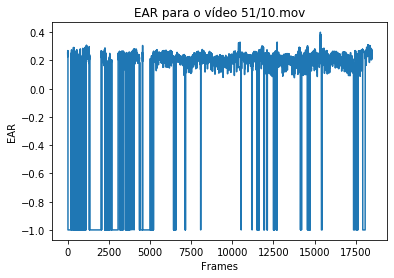

169


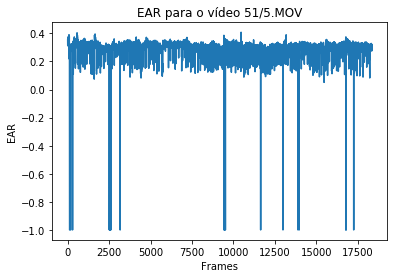

170


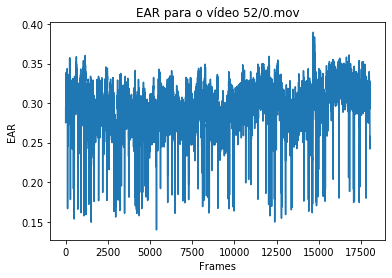

171


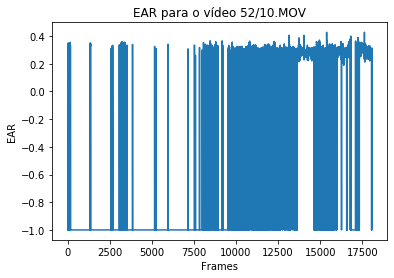

172


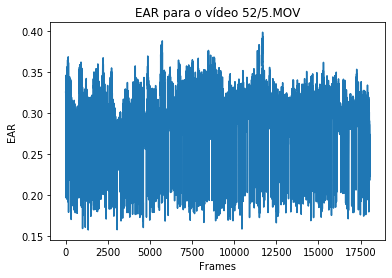

173


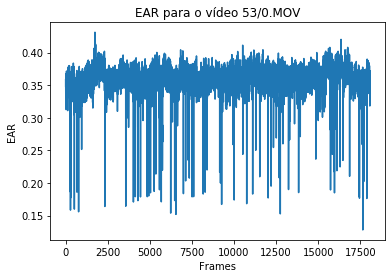

174


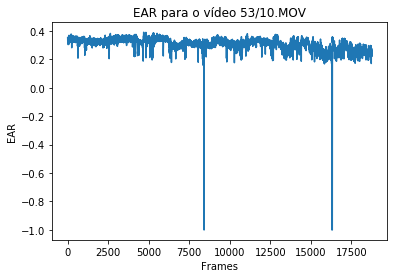

175


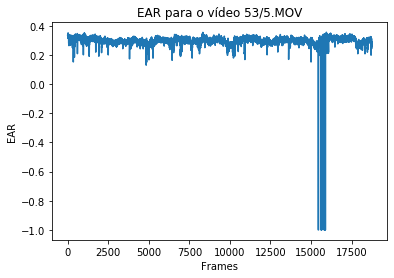

176


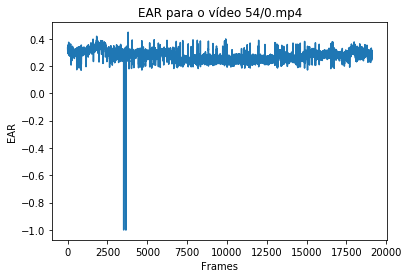

177


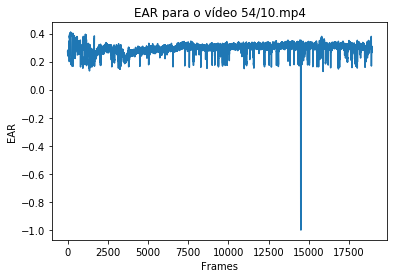

178


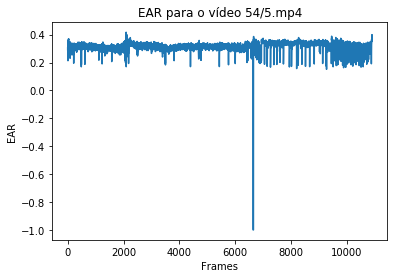

179


In [102]:
for count, video in enumerate(videos):
    plot_video_ear_graph(df, video, 0.3)
    print(count)

# Análise dos dados

In [23]:
ear = df['ear']

In [24]:
import matplotlib.pyplot as plt
plt.plot(ear)

In [25]:
from scipy.ndimage.morphology import grey_opening, grey_closing

ear_opening = grey_opening(ear, 11)
ear_closing = grey_closing(ear, 11)

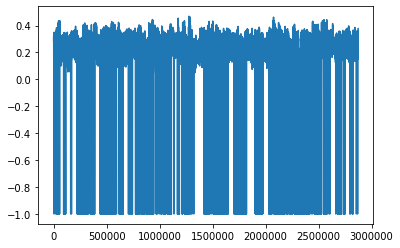

In [26]:
plt.plot(ear_opening)

In [27]:
from skimage.morphology import reconstruction
import numpy as np 

ear_rec = reconstruction(ear - 0.10, ear, selem = np.ones((11,)))

In [ ]:
plt.figure()
plt.plot(ear[2980:3050])
plt.plot(ear[2980:3050]- 0.10)
plt.show()

In [ ]:
plt.plot(ear_rec[2980:3050])